In [151]:
import pandas as pd
import numpy as np

In [152]:
import seaborn as sns
import matplotlib.pyplot as plt

In [153]:
!pip install nltk

In [154]:
data = pd.read_csv("reddit.csv")

In [155]:
data.shape

(37249, 2)

In [156]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37249 entries, 0 to 37248
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   clean_comment  37149 non-null  object
 1   category       37249 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 582.1+ KB


In [157]:
data.sample()["clean_comment"].values

array([' this not hate speech then dont know what '], dtype=object)

In [158]:
data.isnull().sum()

,0
clean_comment,100
category,0


In [159]:
data[data["clean_comment"].isna()]

,clean_comment,category
413,NaN,0
605,NaN,0
2422,NaN,0
2877,NaN,0
3307,NaN,0
...,...,...
35975,NaN,0
36036,NaN,0
37043,NaN,0
37111,NaN,0


In [160]:
data=data.dropna()

In [161]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 37149 entries, 0 to 37248
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   clean_comment  37149 non-null  object
 1   category       37149 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 870.7+ KB


In [162]:
data.duplicated().sum()

np.int64(350)

In [163]:
data.drop_duplicates(inplace=True)

In [164]:
data.duplicated().sum()

np.int64(0)

In [165]:
data[(data["clean_comment"].str.strip()=='')]

,clean_comment,category
181,,0
4432,\n,0
10592,,0
16173,,0
32149,\n,0
34959,,0


In [166]:
data= data[~(data["clean_comment"].str.strip()=='')]

In [167]:
data.shape

(36793, 2)

In [168]:
data["clean_comment"]= data["clean_comment"].str.lower()

In [169]:
data.head()

,clean_comment,category
0,family mormon have never tried explain them t...,1
1,buddhism has very much lot compatible with chr...,1
2,seriously don say thing first all they won get...,-1
3,what you have learned yours and only yours wha...,0
4,for your own benefit you may want read living ...,1


In [170]:
data[data["clean_comment"].apply(lambda x:x.startswith(" ") or x.endswith(" ") )]

,clean_comment,category
0,family mormon have never tried explain them t...,1
1,buddhism has very much lot compatible with chr...,1
2,seriously don say thing first all they won get...,-1
3,what you have learned yours and only yours wha...,0
4,for your own benefit you may want read living ...,1
...,...,...
37241,let the janta decide not ulema clerics,0
37242,hona hai same with vaccination education insu...,0
37246,downvote karna tha par upvote hogaya,0
37247,haha nice,1


In [171]:
data[data["clean_comment"].apply(lambda x : x.startswith(" ")or x.endswith(" "))]

,clean_comment,category
0,family mormon have never tried explain them t...,1
1,buddhism has very much lot compatible with chr...,1
2,seriously don say thing first all they won get...,-1
3,what you have learned yours and only yours wha...,0
4,for your own benefit you may want read living ...,1
...,...,...
37241,let the janta decide not ulema clerics,0
37242,hona hai same with vaccination education insu...,0
37246,downvote karna tha par upvote hogaya,0
37247,haha nice,1


In [172]:
data["clean_comment"]= data["clean_comment"].str.strip()

In [173]:
data[data["clean_comment"].apply(lambda x : x.startswith(" ")or x.endswith(" "))]

,clean_comment,category


In [174]:
data[data["clean_comment"].str.contains(r'http[s]?://|www\.', regex=True, na=False)]


,clean_comment,category


In [175]:
data[data["clean_comment"].str.contains("\n")]

,clean_comment,category
448,what missing jpg\nand why this brilliant edit ...,1
781,india has been ruined congress and populist sc...,-1
847,like aap for its stand corruption and making p...,-1
871,reduced trade\ndeficit stronger rupee aren the...,0
1354,amsa press conference australian maritime safe...,1
...,...,...
35128,火箭o辛基 2016 sughosh bansal mission “make india”...,-1
35230,yikes the title should blind bhakts modi hater...,1
36187,hahahahahhahahah \niska klpd hogya,0
36517,्ा् ी ाी े ो ेी ाी े।\nे ी,0


In [176]:
data["clean_comment"]= data["clean_comment"].str.replace("\n", " " , regex=True)

In [177]:
data[data["clean_comment"].str.contains("\n")]

,clean_comment,category


<Axes: xlabel='category', ylabel='count'>

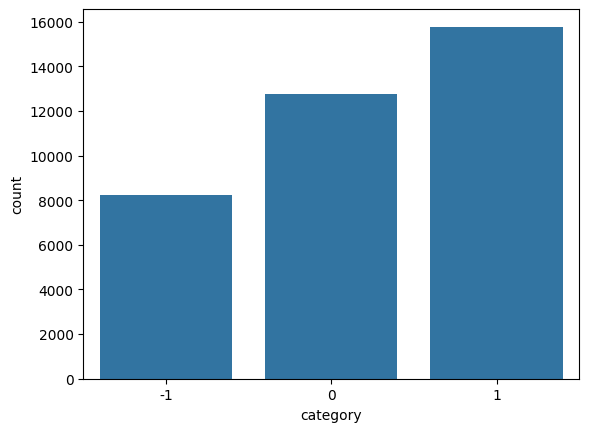

In [178]:
sns.countplot(data=data, x = "category")

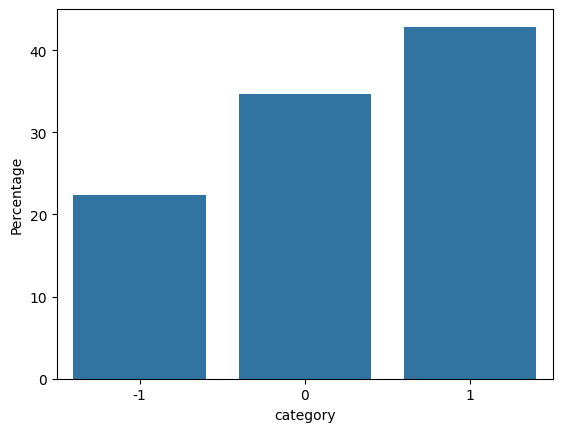

In [179]:
category_perc = data["category"].value_counts(normalize=True) * 100
sns.barplot(x=category_perc.index, y=category_perc.values)
plt.ylabel("Percentage")
plt.show()

In [180]:
data["word_count"]= data["clean_comment"].apply(lambda x : len(x.split(" ")))

In [181]:
data.head()

,clean_comment,category,word_count
0,family mormon have never tried explain them th...,1,39
1,buddhism has very much lot compatible with chr...,1,196
2,seriously don say thing first all they won get...,-1,86
3,what you have learned yours and only yours wha...,0,29
4,for your own benefit you may want read living ...,1,112


In [182]:
data["word_count"].describe()

,word_count
count,36793.000000
mean,29.668497
std,56.786439
min,1.000000
25%,6.000000
50%,13.000000
75%,30.000000
max,1307.000000


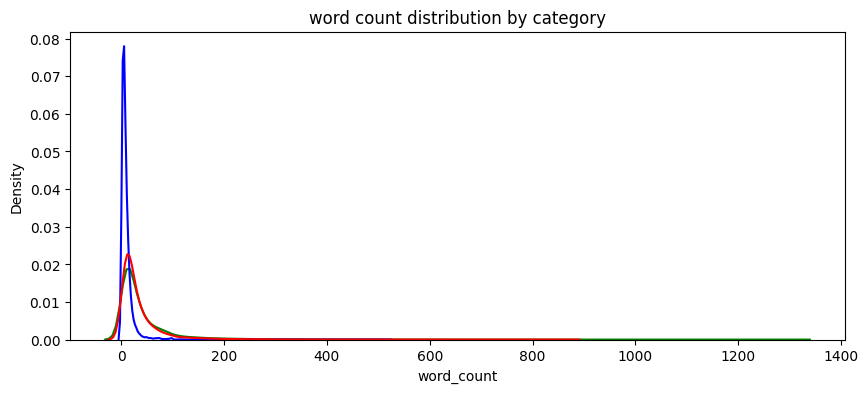

In [183]:
plt.figure(figsize=(10,4))

sns.kdeplot(data[data["category"]==1]["word_count"], label = "Positive", fill = False , color = "green")
sns.kdeplot(data[data["category"]==0]["word_count"], label = "Neutral", fill = False , color = "blue")
sns.kdeplot(data[data["category"]==-1]["word_count"], label = "Negative", fill = False , color = "red")
plt.title("word count distribution by category")

plt.show()


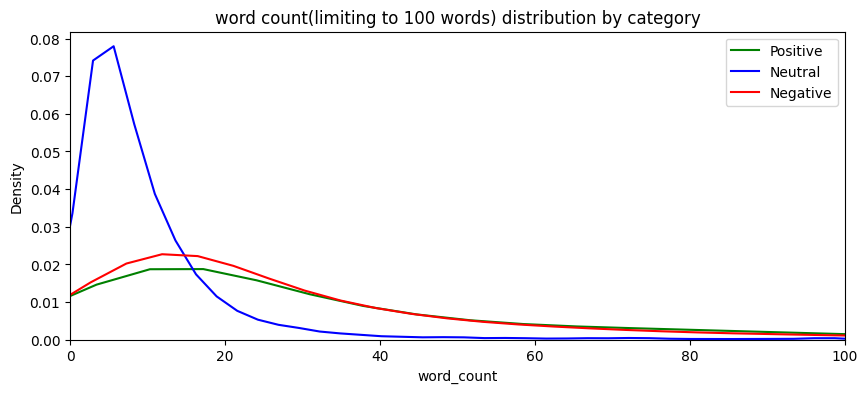

In [184]:
plt.figure(figsize=(10,4))

sns.kdeplot(data[data["category"]==1]["word_count"], label = "Positive", fill=False, color="green")
sns.kdeplot(data[data["category"]==0]["word_count"], label = "Neutral", fill=False, color="blue")
sns.kdeplot(data[data["category"]==-1]["word_count"], label = "Negative", fill=False, color="red")
plt.title("word count(limiting to 100 words) distribution by category")

plt.xlim(0, 100)
plt.legend()
plt.show()


<Axes: ylabel='word_count'>

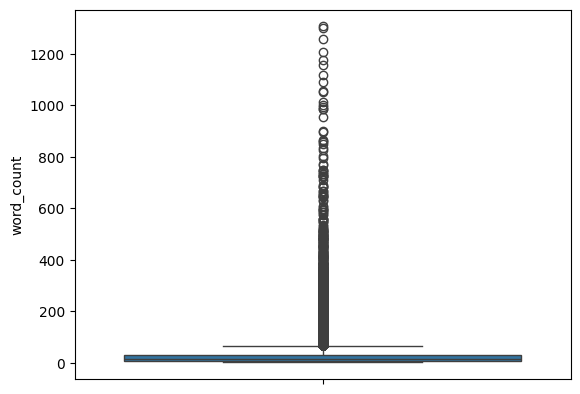

In [185]:
sns.boxplot(data["word_count"])

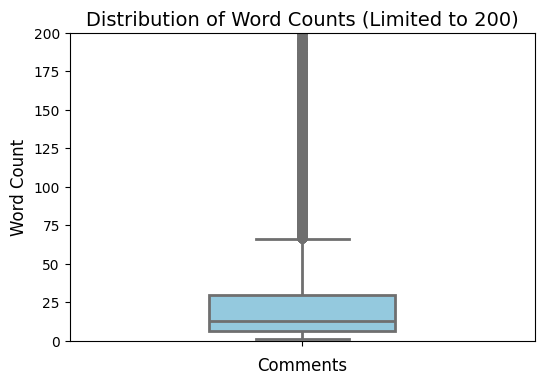

In [186]:
import matplotlib.pyplot as plt

plt.figure(figsize=(6,4))

sns.boxplot(
    data["word_count"],
    width=0.4,
    linewidth=2,
    color="skyblue"
)

plt.ylim(0, 200)

plt.title("Distribution of Word Counts (Limited to 200)", fontsize=14)
plt.xlabel("Comments", fontsize=12)
plt.ylabel("Word Count", fontsize=12)


plt.show()


/tmp/ipython-input-2211717862.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


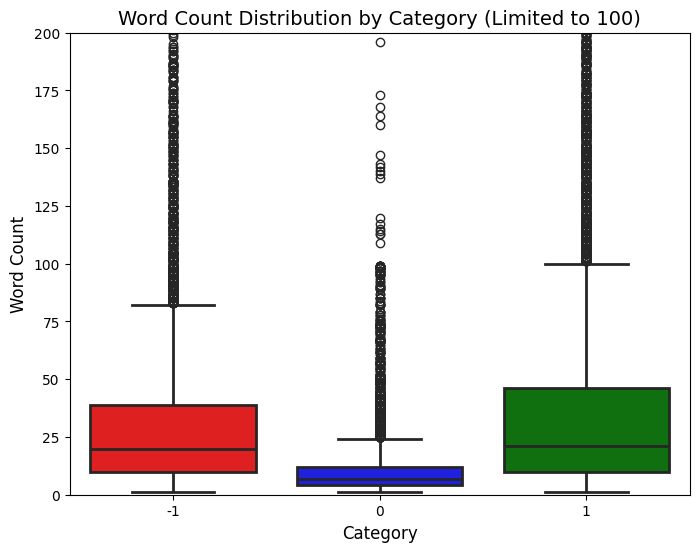

In [187]:
plt.figure(figsize=(8,6))

sns.boxplot(
    data=data,
    x="category",
    y="word_count",
    linewidth=2,
    palette={"1": "green", "0": "blue", "-1": "red"}
)

plt.ylim(0, 200)

plt.title("Word Count Distribution by Category (Limited to 100)", fontsize=14)
plt.xlabel("Category", fontsize=12)
plt.ylabel("Word Count", fontsize=12)

plt.show()


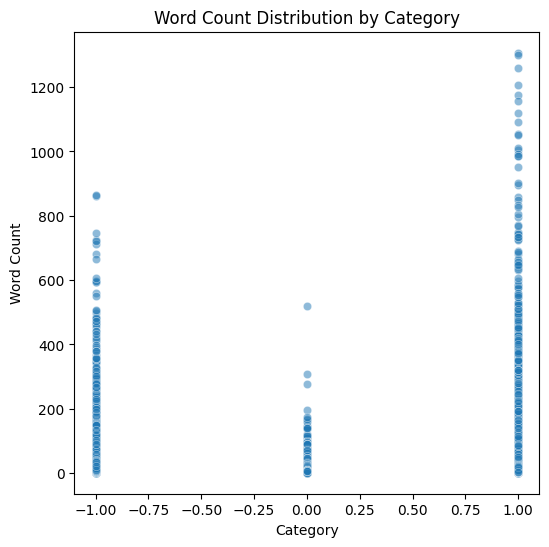

In [188]:
plt.figure(figsize = (6,6))
sns.scatterplot(data= data , x="category", y="word_count", alpha=0.5)
plt.title("Word Count Distribution by Category")
plt.xlabel("Category")
plt.ylabel("Word Count")
plt.show()

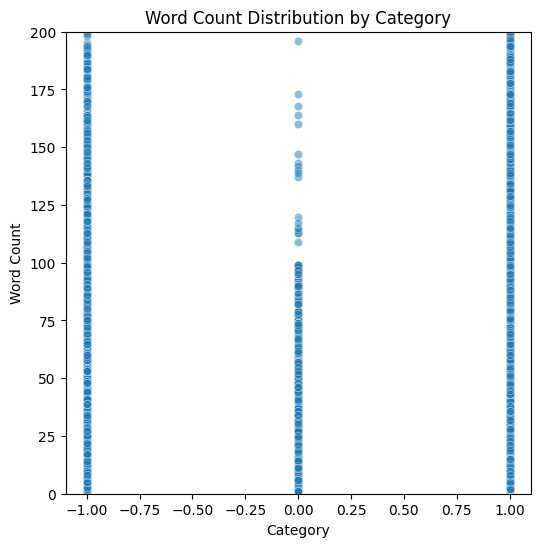

In [189]:

plt.figure(figsize = (6,6))
sns.scatterplot(data= data , x="category", y="word_count", alpha=0.5)
plt.title("Word Count Distribution by Category")
plt.ylim(0,200)
plt.xlabel("Category")
plt.ylabel("Word Count")
plt.show()
#this shows that the negative and psottive comments are longer and neutrall ones are usually shorter

In [190]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [191]:
from nltk.corpus import stopwords



In [192]:
stop_words = set(stopwords.words('english'))


In [193]:
data['num_stop_words']= data["clean_comment"].apply(lambda x: len([word for word in x.split() if word in stop_words]))

In [194]:
data.head()

,clean_comment,category,word_count,num_stop_words
0,family mormon have never tried explain them th...,1,39,13
1,buddhism has very much lot compatible with chr...,1,196,59
2,seriously don say thing first all they won get...,-1,86,40
3,what you have learned yours and only yours wha...,0,29,15
4,for your own benefit you may want read living ...,1,112,45


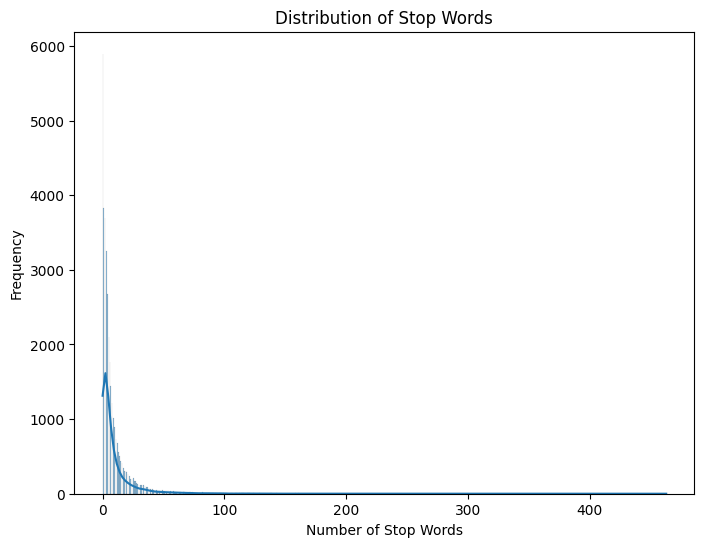

In [195]:
plt.figure(figsize=(8,6))
#KDE stands for Kernel Density Estimation.
#It’s a way to estimate the probability distribution of a dataset (i.e., how the values are spread). Instead of showing just counts like a histogram, KDE smooths things out to show a continuous curve.
sns.histplot(data["num_stop_words"], kde= True)
plt.title("Distribution of Stop Words")
plt.xlabel("Number of Stop Words")
plt.ylabel("Frequency")
plt.show()

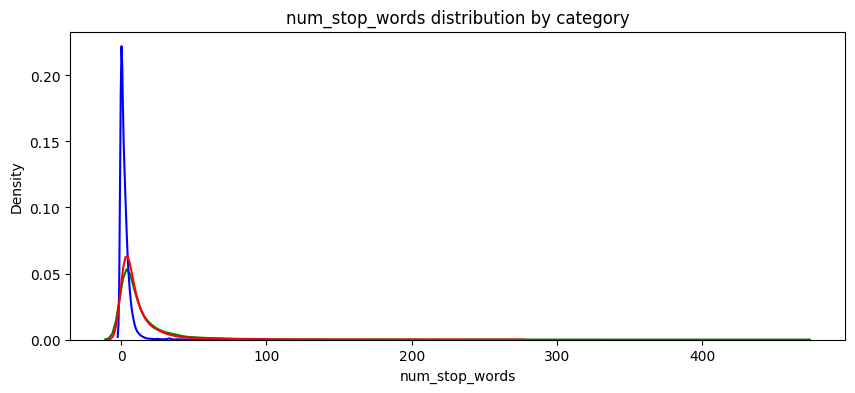

In [196]:
plt.figure(figsize=(10,4))

sns.kdeplot(data[data["category"]==1]["num_stop_words"], label = "Positive", fill = False , color = "green")
sns.kdeplot(data[data["category"]==0]["num_stop_words"], label = "Neutral", fill = False , color = "blue")
sns.kdeplot(data[data["category"]==-1]["num_stop_words"], label = "Negative", fill = False , color = "red")
plt.title("num_stop_words distribution by category")

plt.show()

#neutral category has more stopwords

Text(0, 0.5, 'Number of Stop Words')

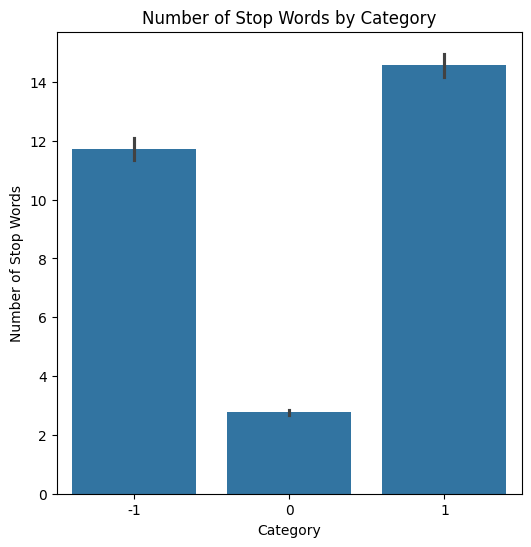

In [197]:
plt.figure(figsize=(6,6))
sns.barplot(data, x="category", y="num_stop_words", estimator='mean')
plt.title("Number of Stop Words by Category")
plt.xlabel("Category")
plt.ylabel("Number of Stop Words")

In [198]:
from collections import Counter

all_stopwords  = [word for comment in data["clean_comment"] for word in comment.split() if word in stop_words]

In [199]:
most_stopwords = Counter(all_stopwords).most_common(25)

In [200]:
most_stopwords

[('the', 57669),
 ('and', 28950),
 ('that', 15372),
 ('this', 13463),
 ('for', 12976),
 ('you', 11723),
 ('are', 10566),
 ('not', 8691),
 ('they', 8654),
 ('have', 8380),
 ('with', 7845),
 ('but', 7264),
 ('will', 6905),
 ('was', 6371),
 ('what', 5270),
 ('all', 5130),
 ('has', 5097),
 ('can', 5037),
 ('from', 4965),
 ('about', 4355),
 ('just', 4261),
 ('there', 4150),
 ('who', 4058),
 ('their', 3938),
 ('his', 3341)]

<Axes: >

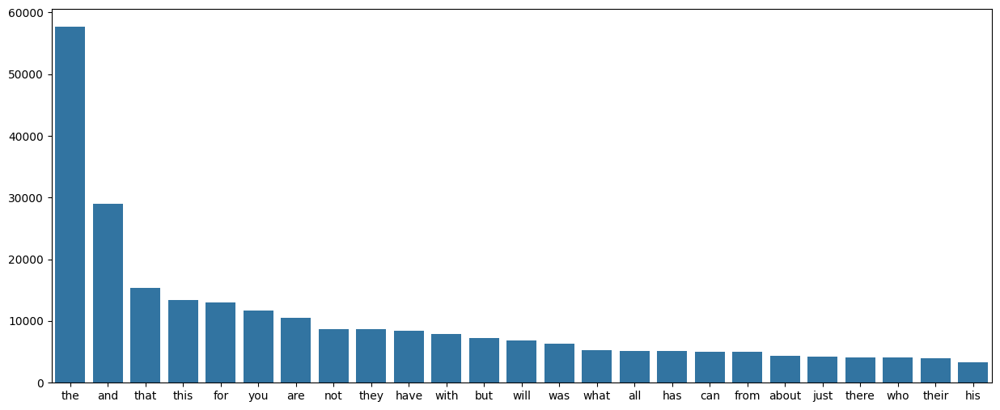

In [201]:
plt.figure(figsize=(15,6))
sns.barplot(x=[ x[0] for x in most_stopwords], y = [ y[1] for y in most_stopwords])

In [202]:
data["num_chars"]= data["clean_comment"].apply(len)

In [203]:
data.head()

,clean_comment,category,word_count,num_stop_words,num_chars
0,family mormon have never tried explain them th...,1,39,13,259
1,buddhism has very much lot compatible with chr...,1,196,59,1268
2,seriously don say thing first all they won get...,-1,86,40,459
3,what you have learned yours and only yours wha...,0,29,15,167
4,for your own benefit you may want read living ...,1,112,45,690


In [204]:
data["num_chars"].describe()

,num_chars
count,36793.000000
mean,181.852798
std,359.702163
min,1.000000
25%,38.000000
50%,80.000000
75%,184.000000
max,8664.000000


In [205]:
whole_text = " ".join(data["clean_comment"])


char_frequency = Counter(whole_text)

char_frq_df = pd.DataFrame(char_frequency.items(), columns = ['character', 'frequency']).sort_values(by='frequency', ascending=False)

In [206]:
import string

In [207]:
data["punct_count"] = data["clean_comment"].str.count(f"[{string.punctuation}]")


In [208]:
data[data["punct_count"]>0]

,clean_comment,category,word_count,num_stop_words,num_chars,punct_count
1322,press statement ministry transport malaysia th...,1,488,123,3217,1
1383,lol somehow looks like altar put urn @ the mid...,1,14,3,66,1
1727,twitter suggests many people cried today count...,1,13,0,85,1
3806,basically proxified his connection and somehow...,-1,132,51,783,2
6069,trends @ 45am 218 243 leads 115 bjp 100,0,9,0,39,1
...,...,...,...,...,...,...
25946,good aapas mein ladh marne chahiye yeh gau klu...,1,23,3,118,1
30259,take offense but compare quality india would o...,0,24,6,134,1
32895,tweet from arvind limbavali see lot people wri...,1,46,13,275,1
33136,trees are not terrorist @ iaf,0,6,2,29,1


In [209]:
from sklearn.feature_extraction.text import CountVectorizer

In [210]:
def get_top_ngrams(corpus, n=None): # corpus IS for mentioning string converted text documents
  vec = CountVectorizer(ngram_range=(2,2) , stop_words='english').fit(corpus)
  print(vec.vocabulary_) # this is the dictionary which is created
  bag_of_words = vec.transform(corpus)
  sum_words = bag_of_words.sum(axis=0)
  words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
  words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
  return words_freq[:n]

In [211]:
top_25_bigrams = get_top_ngrams(data["clean_comment"], n=25)

{'family mormon': 144104, 'mormon tried': 276779, 'tried explain': 434489, 'explain stare': 139622, 'stare puzzled': 398642, 'puzzled time': 338485, 'time time': 428385, 'time like': 427910, 'like kind': 242025, 'kind strange': 227396, 'strange creature': 403832, 'creature nonetheless': 95387, 'nonetheless come': 290173, 'come admire': 77516, 'admire patience': 12676, 'patience calmness': 307699, 'calmness equanimity': 59671, 'equanimity acceptance': 134244, 'acceptance compassion': 8124, 'compassion developed': 81581, 'developed things': 111015, 'things buddhism': 422534, 'buddhism teaches': 55962, 'buddhism lot': 55940, 'lot compatible': 250768, 'compatible christianity': 81610, 'christianity especially': 71731, 'especially considering': 134921, 'considering sin': 86562, 'sin suffering': 387015, 'suffering thing': 408127, 'thing suffering': 422360, 'suffering caused': 408080, 'caused wanting': 64458, 'wanting things': 455774, 'things shouldn': 422969, 'shouldn want': 384161, 'want go

In [212]:
top_25_bigrams

[('free encyclopedia', np.int64(623)),
 ('encyclopedia team', np.int64(598)),
 ('good good', np.int64(409)),
 ('prime minister', np.int64(389)),
 ('best overall', np.int64(375)),
 ('don know', np.int64(352)),
 ('looks like', np.int64(339)),
 ('don think', np.int64(334)),
 ('team reached', np.int64(322)),
 ('social media', np.int64(316)),
 ('movie movie', np.int64(276)),
 ('narendra modi', np.int64(272)),
 ('rahul gandhi', np.int64(264)),
 ('lot lot', np.int64(232)),
 ('reached free', np.int64(224)),
 ('right wing', np.int64(207)),
 ('team sports', np.int64(206)),
 ('overall submitter', np.int64(204)),
 ('submitter best', np.int64(195)),
 ('just like', np.int64(189)),
 ('movie good', np.int64(183)),
 ('amit shah', np.int64(169)),
 ('overall post', np.int64(168)),
 ('people like', np.int64(162)),
 ('post best', np.int64(162))]

/tmp/ipython-input-2257834596.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(y=[ x[0] for x in top_25_bigrams], x= [ y[1] for y in top_25_bigrams], palette='magma')


<Axes: >

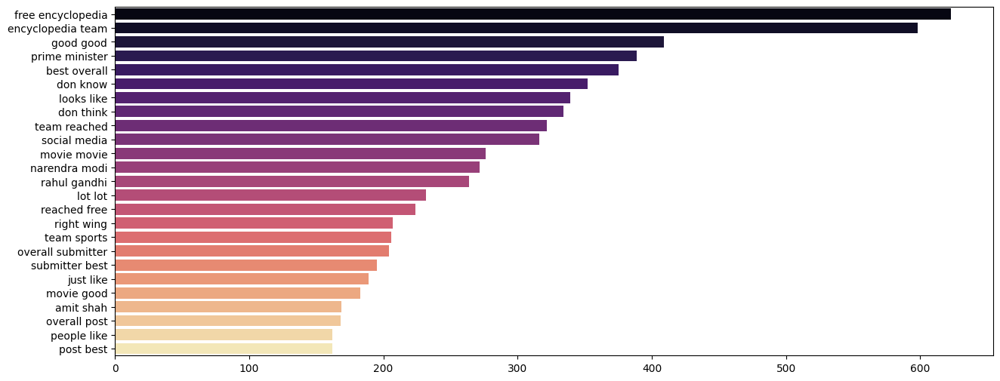

In [213]:
plt.figure(figsize=(15,6))
sns.barplot(y=[ x[0] for x in top_25_bigrams], x= [ y[1] for y in top_25_bigrams], palette='magma')

In [214]:
def get_top_trigrams(corpus, n=None): # corpus IS for mentioning string converted text documents
  vec = CountVectorizer(ngram_range=(3,3) , stop_words='english').fit(corpus)
  print(vec.vocabulary_) # this is the dictionary which is created
  bag_of_words = vec.transform(corpus)
  sum_words = bag_of_words.sum(axis=0)
  words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
  words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
  return words_freq[:n]

In [215]:
top_25_trigrams = get_top_trigrams(data["clean_comment"], n=25)

{'family mormon tried': 166392, 'mormon tried explain': 327474, 'tried explain stare': 513071, 'explain stare puzzled': 161333, 'stare puzzled time': 470944, 'puzzled time time': 401845, 'time time like': 506464, 'time like kind': 505725, 'like kind strange': 283765, 'kind strange creature': 266099, 'strange creature nonetheless': 477124, 'creature nonetheless come': 109091, 'nonetheless come admire': 343929, 'come admire patience': 88265, 'admire patience calmness': 14191, 'patience calmness equanimity': 363749, 'calmness equanimity acceptance': 68752, 'equanimity acceptance compassion': 155631, 'acceptance compassion developed': 9088, 'compassion developed things': 93092, 'developed things buddhism': 126360, 'things buddhism teaches': 498534, 'buddhism lot compatible': 64752, 'lot compatible christianity': 295023, 'compatible christianity especially': 93121, 'christianity especially considering': 81975, 'especially considering sin': 156311, 'considering sin suffering': 99016, 'sin su

/tmp/ipython-input-1336687155.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(y=[ x[0] for x in top_25_trigrams], x= [ y[1] for y in top_25_trigrams], palette='magma')


<Axes: >

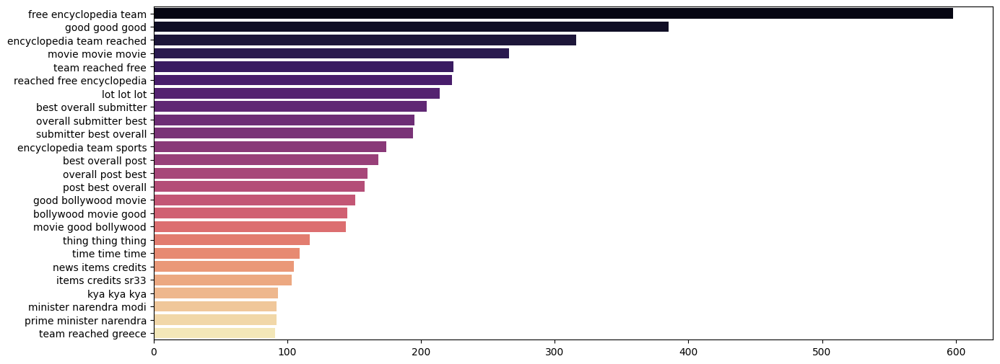

In [216]:
plt.figure(figsize=(15,6))
sns.barplot(y=[ x[0] for x in top_25_trigrams], x= [ y[1] for y in top_25_trigrams], palette='magma')

In [217]:
import re

In [218]:
data["clean_comment"]= data["clean_comment"].apply(lambda x : re.sub(r'[^A-Za-z0-9.,!?;:()\-+$]', ' ', str(x) ))

In [219]:
all_text= " ".join(data["clean_comment"])

In [220]:
char_freq = Counter(all_text)

In [221]:
char_df = pd.DataFrame(char_freq.items(), columns=["Character", "Frequency"]).sort_values(by="Frequency", ascending=False)


In [222]:
char_df

,Character,Frequency
6,,1108700
12,e,666610
13,t,491287
1,a,481134
3,i,401388
9,n,388465
7,o,379908
17,s,355279
8,r,331425
10,h,296748


In [223]:
stopwords = set(stopwords.words('english'))-{ "no", "not", "nor", "never", "none",
    "nothing", "nowhere", "hardly", "scarcely", "barely",
    "don't", "doesn't", "didn't", "isn't", "aren't", "wasn't", "weren't",
    "won't", "wouldn't", "can't", "cannot", "couldn't", "shouldn't", "mustn't"} # we annot emi all stop wrods some are important

In [240]:
stopwords

{'a',
 'about',
 'above',
 'after',
 'again',
 'against',
 'ain',
 'all',
 'am',
 'an',
 'and',
 'any',
 'are',
 'aren',
 'as',
 'at',
 'be',
 'because',
 'been',
 'before',
 'being',
 'below',
 'between',
 'both',
 'but',
 'by',
 'can',
 'couldn',
 'd',
 'did',
 'didn',
 'do',
 'does',
 'doesn',
 'doing',
 'don',
 'down',
 'during',
 'each',
 'few',
 'for',
 'from',
 'further',
 'had',
 'hadn',
 "hadn't",
 'has',
 'hasn',
 "hasn't",
 'have',
 'haven',
 "haven't",
 'having',
 'he',
 "he'd",
 "he'll",
 "he's",
 'her',
 'here',
 'hers',
 'herself',
 'him',
 'himself',
 'his',
 'how',
 'i',
 "i'd",
 "i'll",
 "i'm",
 "i've",
 'if',
 'in',
 'into',
 'is',
 'isn',
 'it',
 "it'd",
 "it'll",
 "it's",
 'its',
 'itself',
 'just',
 'll',
 'm',
 'ma',
 'me',
 'mightn',
 "mightn't",
 'more',
 'most',
 'mustn',
 'my',
 'myself',
 'needn',
 "needn't",
 'now',
 'o',
 'of',
 'off',
 'on',
 'once',
 'only',
 'or',
 'other',
 'our',
 'ours',
 'ourselves',
 'out',
 'over',
 'own',
 're',
 's',
 'same',
 '

In [241]:
data["clean_comment"]= data["clean_comment"].apply(lambda x : " ".join([word for word in x.split() if word.lower() not in stopwords]))

In [242]:
data.sample(5)

,clean_comment,category,word_count,num_stop_words,num_chars,punct_count
31985,people trust issue need look mirror meet one p...,1,27,13,140,0
31687,trust democracy allow vote ambani directly,1,9,3,56,0
21220,need spread horrified not surprised,-1,8,4,49,0
1306,following thread beginning seen answer apologi...,-1,41,22,248,0
18348,definitely recommended,0,2,0,22,0


In [243]:
from nltk.stem import WordNetLemmatizer
nltk.download("wordnet")

lemmatizer= WordNetLemmatizer()

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [244]:
data["clean_comment"]= data["clean_comment"].apply(lambda x: " ".join([lemmatizer.lemmatize(word) for word in x.split()]))

In [245]:
data.sample(5)

,clean_comment,category,word_count,num_stop_words,num_chars,punct_count
21915,bit loop hope asking not criminal offence joke...,1,24,12,132,0
25841,seems like clear majority next highest probabl...,1,19,4,116,0
28881,lmao sad life got good life people chennai who...,1,41,12,223,0
36425,atleast foreign trip get useful business country,1,10,3,62,0
318,modi fap,0,2,0,8,0


In [246]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt


def plot_word_cloud(text):
  wordcloud = WordCloud(width=800, height=400, background_color='white').generate(" ".join(text))
  plt.figure(figsize=(10, 5))
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis('off')

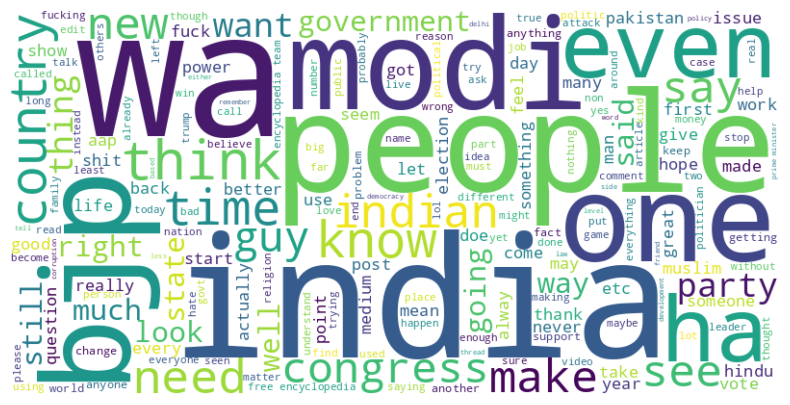

In [247]:
plot_word_cloud(data['clean_comment'])

In [248]:
def plot_top_n_words(data, n=20):
  words = " ".join(data['clean_comment']).split()

  counter = Counter(words)
  most_common_words=counter.most_common(n)

  plt.figure(figsize=(10,10))
  sns.barplot(x=[ x[0] for x in most_common_words], y = [ y[1] for y in most_common_words], palette='magma')
  plt.show()

/tmp/ipython-input-2396014229.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=[ x[0] for x in most_common_words], y = [ y[1] for y in most_common_words], palette='magma')


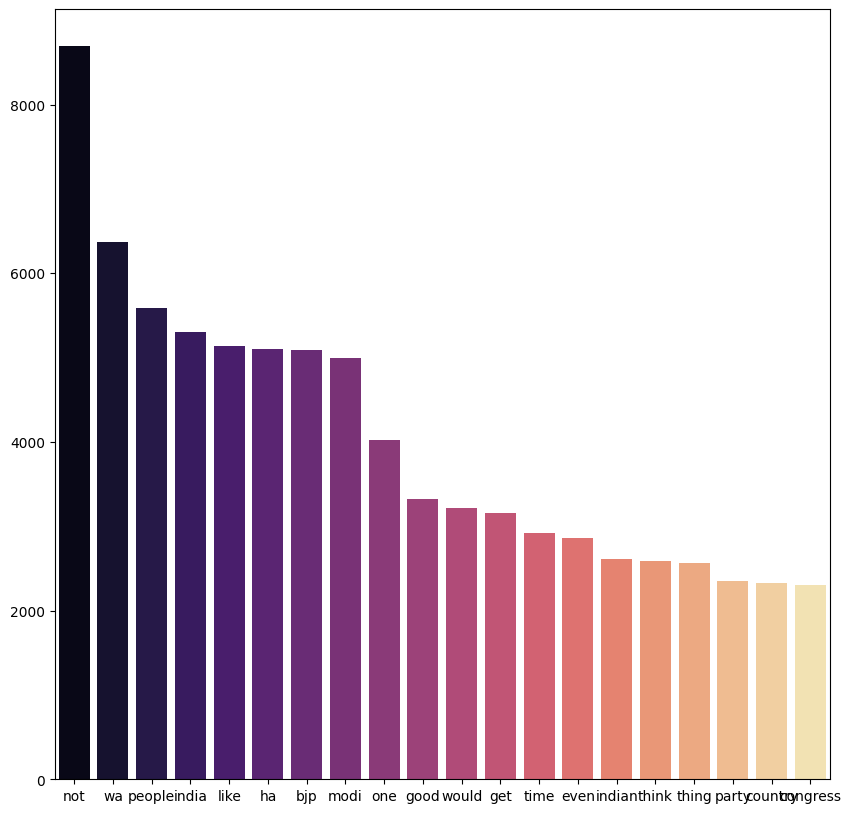

In [249]:
plot_top_n_words(data)

In [266]:
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns

def plot_top_n_words_by_category(data, n=20):
    records = []

    # collect word counts per category
    for cat in data['category'].unique():
        words = " ".join(data[data['category'] == cat]['clean_comment']).split()
        counter = Counter(words)
        most_common_words = counter.most_common(n)

        for word, count in most_common_words:
            records.append([word, cat, count])

    freq_df = pd.DataFrame(records, columns=["word", "category", "count"])

    # pivot so each category becomes a column
    pivot_df = freq_df.pivot_table(index="word", columns="category", values="count", fill_value=0)

    # keep only top N words overall
    pivot_df = pivot_df.loc[pivot_df.sum(axis=1).sort_values(ascending=False).head(n).index]

    # plot stacked bar chart
    pivot_df.plot(kind="bar", stacked=True, figsize=(12, 8), color=["red", "grey", "green"])

    plt.title(f"Top {n} Words (Stacked by Category)")
    plt.xlabel("Words")
    plt.ylabel("Count")
    plt.xticks(rotation=45)
    plt.legend(title="Category")
    plt.show()

In [257]:
data.head()

,clean_comment,category,word_count,num_stop_words,num_chars,punct_count
0,family mormon never tried explain still stare ...,1,39,13,259,0
1,buddhism ha much lot compatible christianity e...,1,196,59,1268,0
2,seriously say thing first get complex explain ...,-1,86,40,459,0
3,learned want teach different focus goal not wr...,0,29,15,167,0
4,benefit may want read living buddha living chr...,1,112,45,690,0


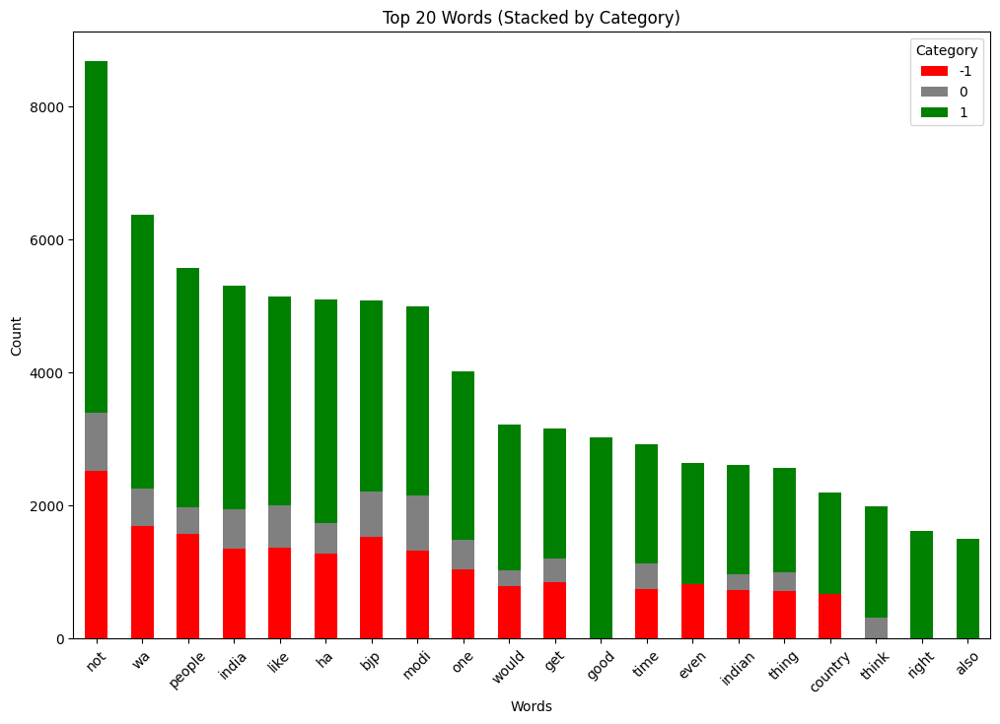

In [267]:
plot_top_n_words_by_category(data)